# Кластеризация текстов с помощью эмбеддингов

Можно заэмбедить тексты с помощью предобученных моделей и кластеризовать их с помощью k-means или другого алгоритма.

            +------------+     +---------------+     +-----------+
            | user_data  |     | post_text_df  |     | feed_data |
            +------------+     +---------------+     +-----------+
            | age        |     | id            |     | timestamp |
            | city       |     | text          |     | user_id   |
            | country    |     | topic         |     | post_id   |
            | exp_group  |     +---------------+     | action    |
            | gender     |           7,023           | target    |
            | id         |                           +-----------+
            | os         |                             76,892,800
            | source     |
            +------------+
                163,205 

In [1]:
import pandas as pd
from sqlalchemy import create_engine
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
import pickle
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import mutual_info_classif, SelectKBest
from catboost import Pool, CatBoostClassifier
import numpy as np
import re
from string import punctuation
from sklearn.metrics import roc_curve, auc

# Создание эмбедингов с помощью text-embedding-ada-002

In [2]:
engine = create_engine(
        "postgresql://robot-startml-ro:pheiph0hahj1Vaif@" # this is the username and password
        "postgres.lab.karpov.courses:6432/startml" # this is the connection string to the database
    )

# Чтение данных таблицы post_text_df
query = "SELECT * FROM post_text_df"
post_text_df = pd.read_sql(query, engine)

In [3]:
post_text_df.head()

,post_id,text,topic
0,1,UK economy facing major risks\n\nThe UK manufa...,business
1,2,Aids and climate top Davos agenda\n\nClimate c...,business
2,3,Asian quake hits European shares\n\nShares in ...,business
3,4,India power shares jump on debut\n\nShares in ...,business
4,5,Lacroix label bought by US firm\n\nLuxury good...,business


In [4]:
post_text_df.shape

(7023, 3)

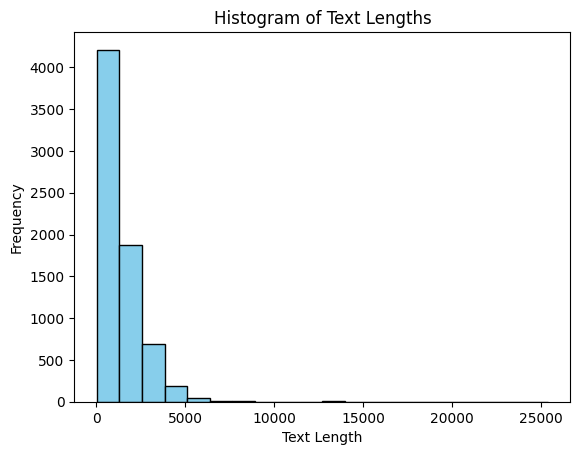

In [5]:
import matplotlib.pyplot as plt

# Assuming post_text_df is your DataFrame

# Create a new column with the length of the texts
post_text_df['text_length'] = post_text_df['text'].apply(len)

# Plot the histogram
plt.hist(post_text_df['text_length'], bins=20, color='skyblue', edgecolor='black')
plt.title('Histogram of Text Lengths')
plt.xlabel('Text Length')
plt.ylabel('Frequency')
plt.show()


In [14]:
import os
import openai
openai.organization = "org-tViLwB60S21WUUopvghusnVk"
openai.api_key = os.getenv("OPENAI_API_KEY")
openai.Model.list()

<OpenAIObject list at 0x25010509a80> JSON: {
  "data": [
    {
      "created": 1649358449,
      "id": "babbage",
      "object": "model",
      "owned_by": "openai",
      "parent": null,
      "permission": [
        {
          "allow_create_engine": false,
          "allow_fine_tuning": false,
          "allow_logprobs": true,
          "allow_sampling": true,
          "allow_search_indices": false,
          "allow_view": true,
          "created": 1669085501,
          "group": null,
          "id": "modelperm-49FUp5v084tBB49tC4z8LPH5",
          "is_blocking": false,
          "object": "model_permission",
          "organization": "*"
        }
      ],
      "root": "babbage"
    },
    {
      "created": 1669599635,
      "id": "text-davinci-003",
      "object": "model",
      "owned_by": "openai-internal",
      "parent": null,
      "permission": [
        {
          "allow_create_engine": false,
          "allow_fine_tuning": false,
          "allow_logprobs": true,
  

In [13]:
import os
os.environ["OPENAI_API_KEY"] = "PLACE_YOUR_KEY_HERE"

In [29]:
import openai
import os

# Make sure to set your OpenAI API key
openai.api_key = os.getenv("OPENAI_API_KEY")

def get_embedding(text, model="text-embedding-ada-002"):
    text = text.replace("\n", " ")
    return openai.Embedding.create(input = [text], model=model)['data'][0]['embedding']

# Take a sample of 5 texts from the 'text' column
sample_df = post_text_df

# Create embeddings for the sampled texts
sample_df['ada_embedding'] = sample_df['text'].apply(lambda x: get_embedding(x, model='text-embedding-ada-002'))

sample_df.to_csv('output/embedded_sample_texts.csv', index=False)


In [9]:
sample_df

NameError: name 'sample_df' is not defined

In [31]:
#check what topics are there in the dataset
print(post_text_df['topic'].unique())

['business' 'covid' 'entertainment' 'sport' 'politics' 'tech' 'movie']


In [6]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
import plotly.express as px

# Load the CSV file you previously saved
df = pd.read_csv('output/embedded_sample_texts.csv')

# Assume the 'ada_embedding' column contains the embeddings as list-like strings
# We need to convert them to actual lists
df['ada_embedding'] = df['ada_embedding'].apply(lambda x: [float(i) for i in x.strip('[]').split(',')])

# Convert lists to numpy array for PCA
embeddings = np.stack(df['ada_embedding'].values)

# Reduce the dimensionality of the embeddings to 2D using PCA
pca = PCA(n_components=2)
components = pca.fit_transform(embeddings)

# Prepare data for the plot
plot_df = pd.DataFrame(data = components, columns = ['Principal Component 1', 'Principal Component 2'])
plot_df['topic'] = df['topic'].values
plot_df['text'] = df['text'].values

# Plot the results
fig = px.scatter(plot_df, x='Principal Component 1', y='Principal Component 2', color='topic', hover_data=['text'])
fig.update_layout(title='Text Embeddings Visualized in 2D using PCA')
fig.show()


In [7]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.express as px

# Load the CSV file you previously saved
df = pd.read_csv('output/embedded_sample_texts.csv')

# Assume the 'ada_embedding' column contains the embeddings as list-like strings
# We need to convert them to actual lists
df['ada_embedding'] = df['ada_embedding'].apply(lambda x: [float(i) for i in x.strip('[]').split(',')])

# Convert lists to numpy array for t-SNE
embeddings = np.stack(df['ada_embedding'].values)

# Reduce the dimensionality of the embeddings to 2D using t-SNE
tsne = TSNE(n_components=2, random_state=0)
components = tsne.fit_transform(embeddings)

# Prepare data for the plot
plot_df = pd.DataFrame(data = components, columns = ['Component 1', 'Component 2'])
plot_df['topic'] = df['topic'].values
plot_df['text'] = df['text'].values

# Plot the results
fig = px.scatter(plot_df, x='Component 1', y='Component 2', color='topic', hover_data=['text'])
fig.update_layout(title='Text Embeddings Visualized in 2D using t-SNE')
fig.show()


In [8]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.express as px

# Load the CSV file you previously saved
df = pd.read_csv('output/embedded_sample_texts.csv')

# Assume the 'ada_embedding' column contains the embeddings as list-like strings
# We need to convert them to actual lists
df['ada_embedding'] = df['ada_embedding'].apply(lambda x: [float(i) for i in x.strip('[]').split(',')])

# Convert lists to numpy array for t-SNE
embeddings = np.stack(df['ada_embedding'].values)

# Reduce the dimensionality of the embeddings to 2D using t-SNE
tsne = TSNE(n_components=2, random_state=0)
components = tsne.fit_transform(embeddings)

# Prepare data for the plot
plot_df = pd.DataFrame(data = components, columns = ['Component 1', 'Component 2'])
plot_df['topic'] = df['topic'].values
# Truncate text to the first 100 characters
plot_df['text_first_100'] = df['text'].apply(lambda x: (x[:97] + '...') if len(x) > 100 else x)

# Truncate text to the second 100 characters
plot_df['text_second_100'] = df['text'].apply(lambda x: (x[100:197] + '...') if len(x) > 200 else (x[100:] + '...'))

# Truncate text to the third 100 characters
plot_df['text_third_100'] = df['text'].apply(lambda x: (x[200:297] + '...') if len(x) > 300 else (x[200:] + '...'))

# Plot the results with additional hover data
fig = px.scatter(plot_df, x='Component 1', y='Component 2', color='topic', 
                 hover_data=['text_first_100', 'text_second_100', 'text_third_100'],
                 size_max=99)  # adjust size here
fig.update_traces(marker=dict(opacity=0.75))  # adjust opacity here
fig.update_traces(marker={'size': 3})
fig.update_layout(title='Text Embeddings Visualized in 2D using t-SNE')
fig.show()



# Let's check the users likes 

First, load your feed_data.csv into a pandas DataFrame.

In [9]:
feed_df = pd.read_csv('~/Desktop/feed_data.csv')

## Randomly selecting the user

In [10]:
selected_user_id = feed_df.sample(n=1)['user_id'].values[0]
liked_posts = feed_df[(feed_df['user_id'] == selected_user_id) & (feed_df['action'] == 'like')]['post_id'].values
plot_df['liked_by_user'] = df['post_id'].isin(liked_posts)

# print selected user
print(f"User {selected_user_id} liked {len(liked_posts)} posts")

User 123720 liked 77 posts


In [11]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go

# Load the CSV file you previously saved
df = pd.read_csv('output/embedded_sample_texts.csv')

# Assume the 'ada_embedding' column contains the embeddings as list-like strings
# We need to convert them to actual lists
df['ada_embedding'] = df['ada_embedding'].apply(lambda x: [float(i) for i in x.strip('[]').split(',')])

# Convert lists to numpy array for t-SNE
embeddings = np.stack(df['ada_embedding'].values)

# Reduce the dimensionality of the embeddings to 2D using t-SNE
tsne = TSNE(n_components=2, random_state=0)
components = tsne.fit_transform(embeddings)

# Prepare data for the plot
plot_df = pd.DataFrame(data = components, columns = ['Component 1', 'Component 2'])
plot_df['topic'] = df['topic'].values
# Truncate text to the first 100 characters
plot_df['text_first_100'] = df['text'].apply(lambda x: (x[:97] + '...') if len(x) > 100 else x)
# Truncate text to the second 100 characters
plot_df['text_second_100'] = df['text'].apply(lambda x: (x[100:197] + '...') if len(x) > 200 else (x[100:] + '...'))
# Truncate text to the third 100 characters
plot_df['text_third_100'] = df['text'].apply(lambda x: (x[200:297] + '...') if len(x) > 300 else (x[200:] + '...'))

# Add column 'liked_by_user' from df to plot_df
plot_df['liked_by_user'] = df['post_id'].isin(liked_posts)

# Create a plotly figure
fig = go.Figure()

# For each unique value in 'topic', add a trace to the figure
for topic in plot_df['topic'].unique():
    fig.add_trace(
        go.Scatter(
            x=plot_df[plot_df['topic'] == topic]['Component 1'],
            y=plot_df[plot_df['topic'] == topic]['Component 2'],
            mode='markers',
            name=topic,
            text=plot_df[plot_df['topic'] == topic][['text_first_100', 'text_second_100', 'text_third_100']],
            marker=dict(
                size=3,
                opacity=0.75,
                line=dict(
                    width=plot_df[plot_df['topic'] == topic]['liked_by_user'].apply(lambda x: 2 if x else 0),
                    color='Black'
                )
            )
        )
    )

# Adjust layout
fig.update_layout(title='Text Embeddings Visualized in 2D using t-SNE')
# Show the figure
fig.show()


## Plotting for 5 random users 

In [12]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go

# Load the feed data
feed_df = pd.read_csv('~/Desktop/feed_data.csv')

# Function to generate a t-SNE plot for a given user
def generate_plot(user_id):
    # Load the CSV file you previously saved
    df = pd.read_csv('output/embedded_sample_texts.csv')

    # Convert 'ada_embedding' column to actual lists
    df['ada_embedding'] = df['ada_embedding'].apply(lambda x: [float(i) for i in x.strip('[]').split(',')])

    # Convert lists to numpy array for t-SNE
    embeddings = np.stack(df['ada_embedding'].values)

    # Reduce the dimensionality of the embeddings to 2D using t-SNE
    tsne = TSNE(n_components=2, random_state=0)
    components = tsne.fit_transform(embeddings)

    # Prepare data for the plot
    plot_df = pd.DataFrame(data = components, columns = ['Component 1', 'Component 2'])
    plot_df['topic'] = df['topic'].values
    plot_df['text_first_100'] = df['text'].apply(lambda x: (x[:97] + '...') if len(x) > 100 else x)
    plot_df['text_second_100'] = df['text'].apply(lambda x: (x[100:197] + '...') if len(x) > 200 else (x[100:] + '...'))
    plot_df['text_third_100'] = df['text'].apply(lambda x: (x[200:297] + '...') if len(x) > 300 else (x[200:] + '...'))

    # Get the posts liked by the user
    liked_posts = feed_df[(feed_df['user_id'] == user_id) & (feed_df['action'] == 'like')]['post_id'].values
    plot_df['liked_by_user'] = df['post_id'].isin(liked_posts)

    # Create a plotly figure
    fig = go.Figure()

    # For each unique value in 'topic', add a trace to the figure
    for topic in plot_df['topic'].unique():
        fig.add_trace(
            go.Scatter(
                x=plot_df[plot_df['topic'] == topic]['Component 1'],
                y=plot_df[plot_df['topic'] == topic]['Component 2'],
                mode='markers',
                name=topic,
                text=plot_df[plot_df['topic'] == topic][['text_first_100', 'text_second_100', 'text_third_100']],
                marker=dict(
                    size=3,
                    opacity=0.75,
                    line=dict(
                        width=plot_df[plot_df['topic'] == topic]['liked_by_user'].apply(lambda x: 2 if x else 0),
                        color='Black'
                    )
                )
            )
        )

    # Adjust layout
    fig.update_layout(title=f'Text Embeddings Visualized in 2D using t-SNE (User {user_id})')
    # Show the figure
    fig.show()

# Generate 5 plots for 5 random users
for _ in range(5):
    selected_user_id = feed_df.sample(n=1)['user_id'].values[0]
    generate_plot(selected_user_id)


In [13]:
# Count the number of likes each user has given
like_counts = feed_df[feed_df['action'] == 'like']['user_id'].value_counts()

# Find the user who has given the most likes
most_likes_user_id = like_counts.idxmax()

# Generate a plot for this user
generate_plot(most_likes_user_id)


In [14]:
# Calculate the number of likes each post has received
like_counts_per_post = feed_df[feed_df['action'] == 'like']['post_id'].value_counts()

# Create a histogram of the number of likes per post
fig = px.histogram(like_counts_per_post, nbins=50)

# Add a title and labels to the axes
fig.update_layout(
    title_text='Distribution of Likes Per Post',
    xaxis_title_text='Number of Likes',
    yaxis_title_text='Number of Posts',
)

# Show the figure
fig.show()


In [15]:
# Group the feed_df by 'post_id' and count the number of likes each post received
likes_count_df = feed_df[feed_df['action'] == 'like'].groupby('post_id').size().reset_index(name='like_count')

# Merge likes_count_df with df on 'post_id'
df = pd.merge(df, likes_count_df, how='left', on='post_id')

# Replace NaN values in 'like_count' with 0 (in case there are posts with no likes)
df['like_count'] = df['like_count'].fillna(0)


In [16]:
# Create a column in the dataframe representing the count of likes for each post
plot_df['like_count'] = df['like_count'].values

# Update the plot command to color points based on 'like_count' using the 'Plasma' color scale
fig = px.scatter(plot_df, x='Component 1', y='Component 2', color='like_count', 
                 hover_data=['text_first_100', 'text_second_100', 'text_third_100'],
                 color_continuous_scale='Plasma',  # Change color scale here
                 size_max=99)

fig.update_traces(marker=dict(opacity=0.75))  # adjust opacity here
fig.update_traces(marker={'size': 3})
fig.update_layout(title='Text Embeddings Visualized in 2D using t-SNE')
fig.show()


# Clustering the blobs of data

In [17]:
from sklearn.mixture import GaussianMixture

# Decide on the number of clusters you want to use
n_clusters = 30

# Fit the GaussianMixture model to your data
gmm = GaussianMixture(n_components=n_clusters, random_state=0)
gmm.fit(embeddings)

# Predict the cluster labels for each data point
labels = gmm.predict(embeddings)

# Add the cluster labels to your dataframe
plot_df['cluster'] = labels

# Plot the results with additional hover data, coloring points by cluster label
fig = px.scatter(plot_df, x='Component 1', y='Component 2', color='cluster', 
                 hover_data=['text_first_100', 'text_second_100', 'text_third_100'],
                 size_max=99)

fig.update_traces(marker=dict(opacity=0.75))  # adjust opacity here
fig.update_traces(marker={'size': 3})
fig.update_layout(
    title='Text Embeddings Visualized in 2D using t-SNE with Gaussian Mixture Clustering',
)
fig.show()


# Clustering using K-Means

c:\Users\Alex\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



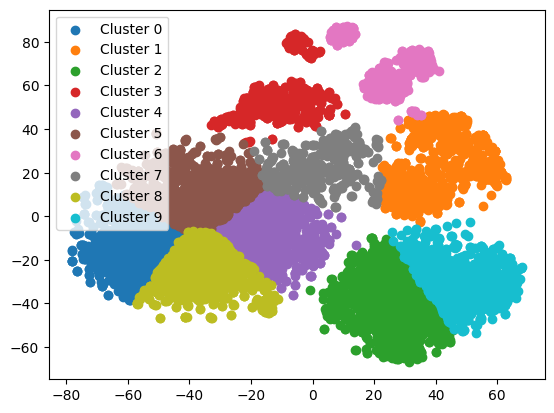

In [8]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Load the CSV file you previously saved
df = pd.read_csv('output/embedded_sample_texts.csv')

# We need to convert them to actual lists
df['ada_embedding'] = df['ada_embedding'].apply(lambda x: [float(i) for i in x.strip('[]').split(',')])

# Convert lists to numpy array for t-SNE
embeddings = np.stack(df['ada_embedding'].values)


# Reduce dimensionality with t-SNE
tsne = TSNE(n_components=2, random_state=0)  # You can set your own random state for reproducibility
embeddings_2d = tsne.fit_transform(embeddings)

# Perform KMeans clustering
n_clusters = 10  # Choose number of clusters here
kmeans = KMeans(n_clusters=n_clusters, random_state=0)  # You can set your own random state for reproducibility
labels = kmeans.fit_predict(embeddings_2d)

# Add t-SNE 2D embeddings and cluster labels to DataFrame
df['tsne-2d-one'] = embeddings_2d[:,0]
df['tsne-2d-two'] = embeddings_2d[:,1]
df['cluster'] = labels

# Visualize clusters using matplotlib
fig, ax = plt.subplots()
for cluster in range(n_clusters):
    ax.scatter(df[df['cluster'] == cluster]['tsne-2d-one'], df[df['cluster'] == cluster]['tsne-2d-two'], label=f'Cluster {cluster}')
ax.legend()
plt.show()


# Spectral clustering method

In [3]:
import pandas as pd
df = pd.read_csv('output/embedded_sample_texts.csv')

In [2]:
df


,post_id,text,topic,text_length,ada_embedding
0,1,UK economy facing major risks\n\nThe UK manufa...,business,1967,"[-0.035833779722452164, -0.03178803250193596, ..."
1,2,Aids and climate top Davos agenda\n\nClimate c...,business,2701,"[-0.0116657093167305, -0.024329274892807007, -..."
2,3,Asian quake hits European shares\n\nShares in ...,business,3408,"[-0.0020042082760483027, -0.014565137214958668..."
3,4,India power shares jump on debut\n\nShares in ...,business,1026,"[0.007435990497469902, -0.0347365103662014, 0...."
4,5,Lacroix label bought by US firm\n\nLuxury good...,business,889,"[-0.014101077802479267, 0.006671763490885496, ..."
...,...,...,...,...,...
7018,7315,"OK, I would not normally watch a Farrelly brot...",movie,803,"[-0.01113878097385168, -0.037733033299446106, ..."
7019,7316,I give this movie 2 stars purely because of it...,movie,800,"[-0.01504735741764307, 0.0032886520493775606, ..."
7020,7317,I cant believe this film was allowed to be mad...,movie,636,"[-0.020096007734537125, -0.015845973044633865,..."
7021,7318,The version I saw of this film was the Blockbu...,movie,728,"[-0.006608619354665279, -0.024858294054865837,..."


In [4]:
import numpy as np
from sentence_transformers import SentenceTransformer
import umap.umap_ as umap
import hdbscan

# Load the sentence transformer
model = SentenceTransformer('all-MiniLM-L6-v2')

# Extract the text data from the dataframe
texts = df['text'].values

# Generate embeddings for the texts
embeddings = model.encode(texts)

# Use UMAP to reduce dimensionality
umap_embeddings = umap.UMAP(n_neighbors=15, 
                             n_components=5, 
                             metric='cosine').fit_transform(embeddings)

# Use HDBSCAN to cluster the embeddings
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',                      
                          cluster_selection_method='eom').fit(umap_embeddings)

# Add the cluster labels to the dataframe
df['cluster'] = cluster.labels_

# Print the dataframe
print(df)


      post_id                                               text     topic  \
0           1  UK economy facing major risks\n\nThe UK manufa...  business   
1           2  Aids and climate top Davos agenda\n\nClimate c...  business   
2           3  Asian quake hits European shares\n\nShares in ...  business   
3           4  India power shares jump on debut\n\nShares in ...  business   
4           5  Lacroix label bought by US firm\n\nLuxury good...  business   
...       ...                                                ...       ...   
7018     7315  OK, I would not normally watch a Farrelly brot...     movie   
7019     7316  I give this movie 2 stars purely because of it...     movie   
7020     7317  I cant believe this film was allowed to be mad...     movie   
7021     7318  The version I saw of this film was the Blockbu...     movie   
7022     7319  Piece of subtle art. Maybe a masterpiece. Doub...     movie   

      text_length                                      ada_embe

In [8]:
# print number of unique clusters
print(len(set(labels)))

30


In [1]:
import numpy
print(numpy.__version__)


1.24.0


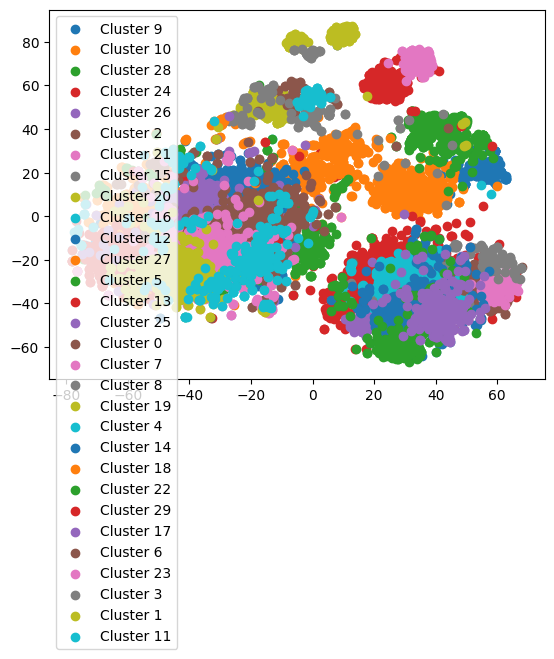

In [7]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt

# Convert lists to numpy array for t-SNE
embeddings = np.stack(df['ada_embedding'].values)

# Reduce dimensionality with t-SNE
tsne = TSNE(n_components=2, random_state=0)  # You can set your own random state for reproducibility
embeddings_2d = tsne.fit_transform(embeddings)

# Decide on the number of clusters you want to use
n_clusters = 30

# Fit the GaussianMixture model to your data
gmm = GaussianMixture(n_components=n_clusters, random_state=0)
gmm.fit(embeddings)

# Predict the cluster labels for each data point
labels = gmm.predict(embeddings)

# Add t-SNE 2D embeddings and cluster labels to DataFrame
df['tsne-2d-one'] = embeddings_2d[:,0]
df['tsne-2d-two'] = embeddings_2d[:,1]
df['cluster'] = labels

# Visualize clusters using matplotlib
fig, ax = plt.subplots()
clusters = df['cluster'].unique()
for cluster in clusters:
    ax.scatter(df[df['cluster'] == cluster]['tsne-2d-one'], df[df['cluster'] == cluster]['tsne-2d-two'], label=f'Cluster {cluster}')
ax.legend()
plt.show()


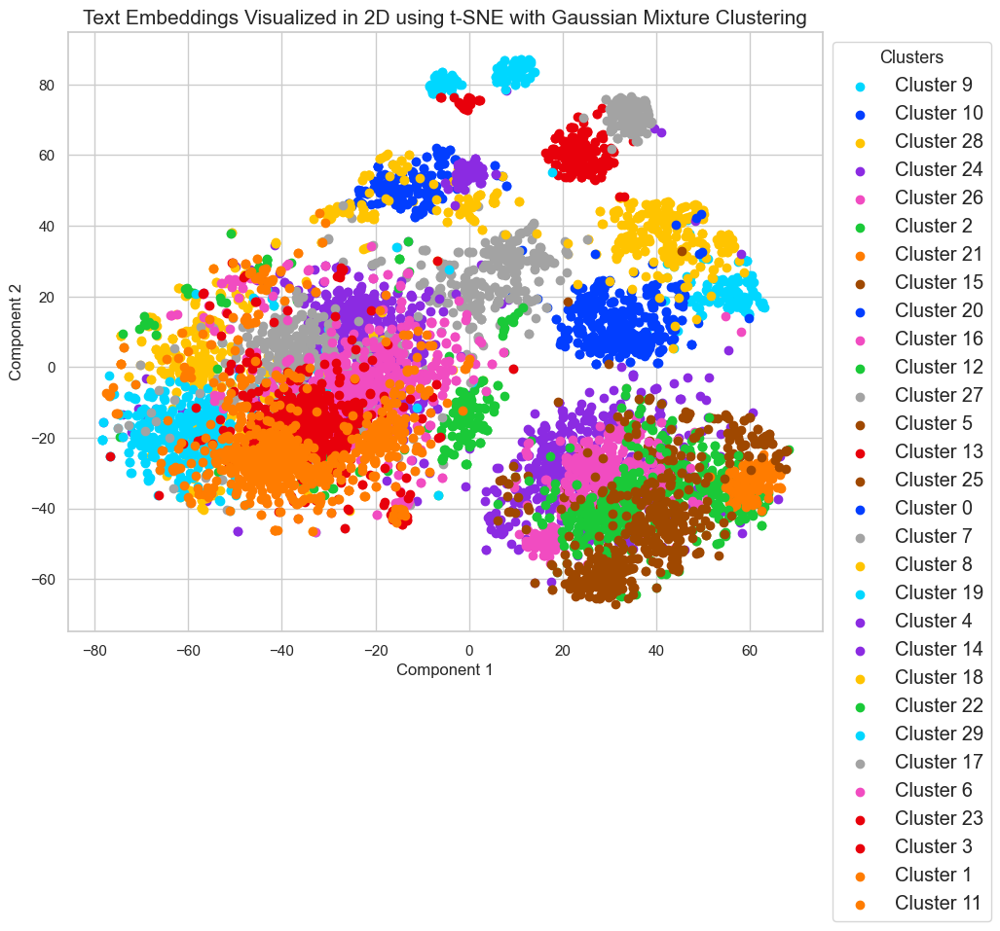

In [9]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt
import seaborn as sns

# Convert lists to numpy array for t-SNE
embeddings = np.stack(df['ada_embedding'].values)

# Reduce dimensionality with t-SNE
tsne = TSNE(n_components=2, random_state=0)  # You can set your own random state for reproducibility
embeddings_2d = tsne.fit_transform(embeddings)

# Decide on the number of clusters you want to use
n_clusters = 30

# Fit the GaussianMixture model to your data
gmm = GaussianMixture(n_components=n_clusters, random_state=0)
gmm.fit(embeddings)

# Predict the cluster labels for each data point
labels = gmm.predict(embeddings)

# Add t-SNE 2D embeddings and cluster labels to DataFrame
df['tsne-2d-one'] = embeddings_2d[:,0]
df['tsne-2d-two'] = embeddings_2d[:,1]
df['cluster'] = labels

# Visualize clusters using matplotlib
plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
palette = sns.color_palette("bright", n_clusters)
clusters = df['cluster'].unique()

for cluster in clusters:
    plt.scatter(df[df['cluster'] == cluster]['tsne-2d-one'], df[df['cluster'] == cluster]['tsne-2d-two'], 
                label=f'Cluster {cluster}', color=palette[cluster])

plt.title('Text Embeddings Visualized in 2D using t-SNE with Gaussian Mixture Clustering', fontsize=15)
plt.xlabel('Component 1', fontsize=12)
plt.ylabel('Component 2', fontsize=12)
plt.legend(title='Clusters', title_fontsize='13', fontsize='large', bbox_to_anchor=(1, 1))
plt.grid(True)
plt.show()


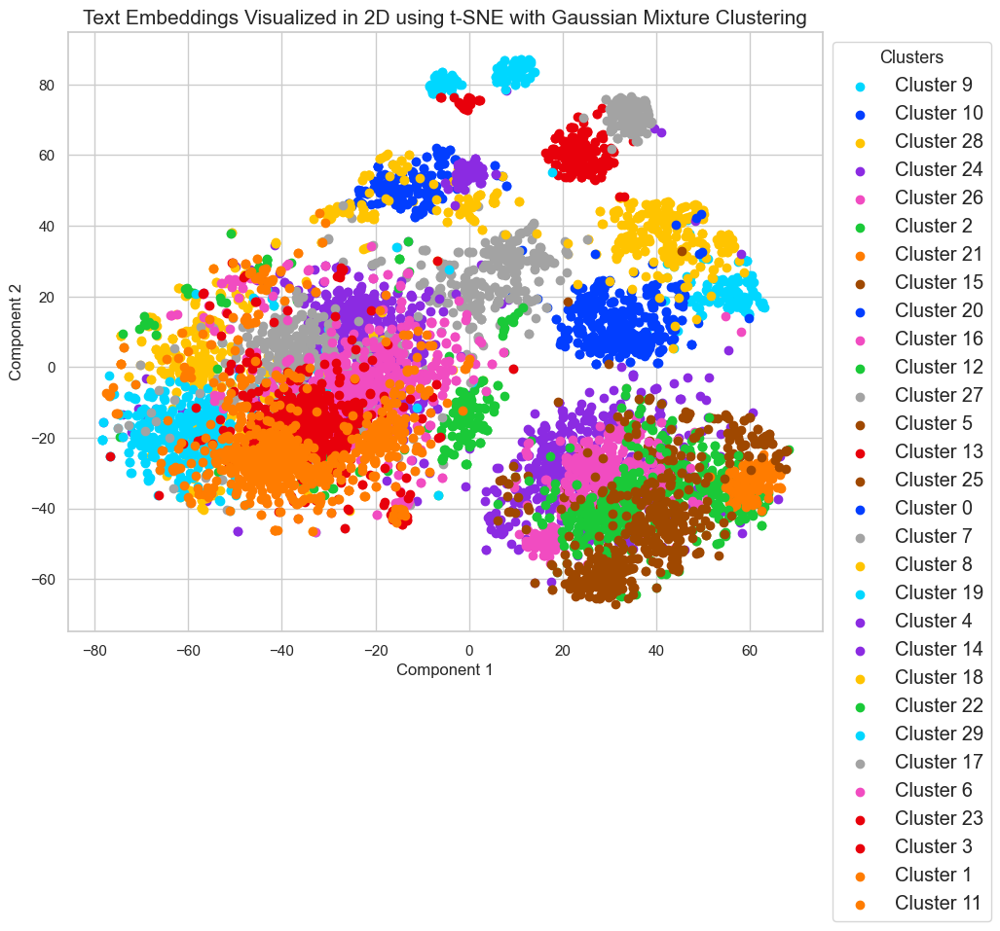

In [10]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt
import seaborn as sns

# Convert lists to numpy array for t-SNE
embeddings = np.stack(df['ada_embedding'].values)

# Reduce dimensionality with t-SNE
tsne = TSNE(n_components=2, random_state=0)  # You can set your own random state for reproducibility
embeddings_2d = tsne.fit_transform(embeddings)

# Decide on the number of clusters you want to use
n_clusters = 30

# Fit the GaussianMixture model to your data
gmm = GaussianMixture(n_components=n_clusters, random_state=0)
gmm.fit(embeddings)

# Predict the cluster labels for each data point
labels = gmm.predict(embeddings)

# Add t-SNE 2D embeddings and cluster labels to DataFrame
df['tsne-2d-one'] = embeddings_2d[:,0]
df['tsne-2d-two'] = embeddings_2d[:,1]
df['cluster'] = labels

# Visualize clusters using matplotlib
plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
palette = sns.color_palette("bright", n_clusters)
clusters = df['cluster'].unique()

for cluster in clusters:
    plt.scatter(df[df['cluster'] == cluster]['tsne-2d-one'], df[df['cluster'] == cluster]['tsne-2d-two'], 
                label=f'Cluster {cluster}', color=palette[cluster])

plt.title('Text Embeddings Visualized in 2D using t-SNE with Gaussian Mixture Clustering', fontsize=15)
plt.xlabel('Component 1', fontsize=12)
plt.ylabel('Component 2', fontsize=12)
plt.legend(title='Clusters', title_fontsize='13', fontsize='large', bbox_to_anchor=(1, 1))
plt.grid(True)
plt.show()


In [ ]:
# saving clusterized df
df.to_csv('clusterized_df.csv', index=False)